In [1]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
import sys
import tqdm

sys.path.insert(0, '/mnt/data/molchanov/dltranz')

from domyshnik.models import *
from domyshnik.data import *
from domyshnik.constants import *
from domyshnik.utils import *

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.colors as mcolors


def draw(imgs):
        if isinstance(imgs, list):
            imgs = torch.stack(imgs)
        fig = plt.figure()
        rows, columns = 1, imgs.shape[0]
        for i in range(imgs.shape[0]):
            fig.add_subplot(rows, columns, i+1)
            plt.imshow(imgs[i])
        plt.show()
        
def draw_rgb(imgs):
    if isinstance(imgs, list):
        imgs = torch.stack(imgs)
    fig = plt.figure()
    rows, columns = 1, imgs.shape[0]
    for i in range(imgs.shape[0]):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(imgs[i].transpose(0, 1).transpose(1, 2))
    plt.show()
    
        
%matplotlib inline

model _params:
        CURRENT_PARAMS cifar10_metric_learning_global
        N_AUGMENTS 5
        LEARNING_RATE 0.002
        GAMMA 0.9025
        BATCH_SIZE 256
        EPOCHS 50
        SAMPLING_STRATEGY HardNegativePair
        NEGATIVES_COUNT 5
        MARGING 0.5
        STEP_SIZE 5
        MODEL_POSTFIX cifar10_global_c50_caug5_iaug2_cmrg03_imrg01_v2
        ADD_INFO {'centroids_count': 50, 'losses': [{'name': 'InClusterisationLoss'}, {'name': 'ContrastiveLossOriginal_centroids', 'marging': 0.3, 'neg_count': 5}, {'name': 'ContrastiveLossOriginal_images', 'marging': 0.1, 'neg_count': 2}], 'n_augs_imgs': 2}
        ERROR_RATE 0.5
       


# Metric Learning MNIST Test 

In [2]:
#model = get_mnist_metriclearning_model()
model = get_mnist_metriclearning_persample_model()
model

load model /mnt/data/molchanov/models/mnist_per_sampl_mnist_metric_learning.w


MnistMetricLearningNet3(
  (w): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(


In [3]:
data_loader = get_mnist_test_loader(BATCH_SIZE, n_augments=N_AUGMENTS)
sample = next(iter(data_loader))
data = sample[0].view(-1, sample[0].size(-2), sample[0].size(-1))
draw(sample[0][0])

RuntimeError: Caught RuntimeError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/mnt/data/molchanov/miniconda3/lib/python3.7/site-packages/torch/utils/data/_utils/worker.py", line 178, in _worker_loop
    data = fetcher.fetch(index)
  File "/mnt/data/molchanov/miniconda3/lib/python3.7/site-packages/torch/utils/data/_utils/fetch.py", line 44, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/mnt/data/molchanov/miniconda3/lib/python3.7/site-packages/torch/utils/data/_utils/fetch.py", line 44, in <listcomp>
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/mnt/data/molchanov/dltranz/domyshnik/data.py", line 132, in __getitem__
    imgs = [self.base_aug(img)] + [self.aug(img) for i in range(self.n_augments)]
  File "/mnt/data/molchanov/miniconda3/lib/python3.7/site-packages/torchvision/transforms/transforms.py", line 70, in __call__
    img = t(img)
  File "/mnt/data/molchanov/miniconda3/lib/python3.7/site-packages/torchvision/transforms/transforms.py", line 175, in __call__
    return F.normalize(tensor, self.mean, self.std, self.inplace)
  File "/mnt/data/molchanov/miniconda3/lib/python3.7/site-packages/torchvision/transforms/functional.py", line 218, in normalize
    tensor.sub_(mean[:, None, None]).div_(std[:, None, None])
RuntimeError: output with shape [1, 28, 28] doesn't match the broadcast shape [3, 28, 28]


In [4]:
embeds = model(sample[0])

In [5]:
distances = torch.matmul(embeds, embeds.transpose(0, 1))
for i in range(distances.shape[0]):
    distances[i, i] = -100

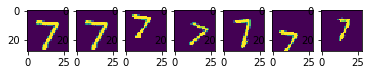

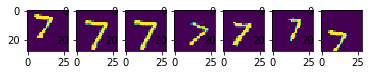

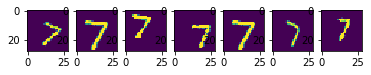

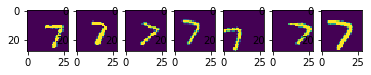

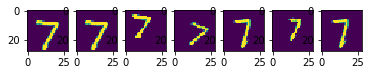

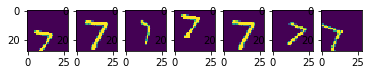

In [ ]:
for i in range(distances.shape[0]):
    vals, idx = torch.sort(distances[i], descending=True)
    idx = [i] + idx[:N_AUGMENTS + 1].numpy().tolist()
    imgs = data[idx]
    draw(imgs)

# Domyshnik Mnist Test

In [ ]:
import torch.nn.functional as F

In [ ]:
data_loader = get_mnist_test_loader(BATCH_SIZE, n_augments=N_AUGMENTS, augment_labels=True)
sample = next(iter(data_loader))
data = sample[0].view(-1, sample[0].size(-2), sample[0].size(-1))
draw(sample[0][0])

In [ ]:
sample[1]

# experiment 1 (domyshnik net)

In [ ]:
info = mnist_domyshnik_lunch_info
sample = next(iter(info.test_loader))

In [ ]:
model = get_mnist_domyshnik_model()
model

In [ ]:
out = model(sample[0])
out = out.view(BATCH_SIZE, N_AUGMENTS + 1, out.size(-1))
out = F.softmax(out, dim=-1)
out.size()


In [ ]:
draw(sample[0][0])

In [ ]:
out0 = out[0]
dists = torch.matmul(out0, out0.transpose(0, 1))
'max', dists.max(), 'min', dists.min()

In [ ]:
draw(sample[0][10])

In [ ]:
out1 = out[1]
dists = torch.matmul(out0, out1.transpose(0, 1))
'max', dists.max(), 'min', dists.min()

In [ ]:
print(out[0, 0])
print(out[0, 1])
print(out[0, 2])
print(out[0, 3])

print(out[10, 0])
print(out[110, 1])
print(out[23, 2])
print(out[4, 3])

# experiment 2 metric learning simularity

In [ ]:
#m_model = get_mnist_metriclearning_model()
m_model = get_mnist_metriclearning_persample_model()
m_model

In [ ]:
m_out = m_model(sample[0])
m_out = m_out.view(BATCH_SIZE, N_AUGMENTS + 1, m_out.size(-1))
m_out.size()

### distance to negatives

In [ ]:
dists = F.pairwise_distance(m_out[0], m_out[10])
'max', dists.max().item(), 'min', dists.min().item()

### distance to self 

In [ ]:
dists = F.pairwise_distance(m_out[0], m_out[0][torch.randperm(m_out[0].size(0))])
'max', dists.max().item(), 'min', dists.min().item()
dists

In [ ]:
t = -1
for i in range(BATCH_SIZE):
    dists = F.pairwise_distance(m_out[i], m_out[i][torch.randperm(m_out0.size(0))])
    if t < dists.max().item():
        t = dists.max().item()
'max', t

In [ ]:
t = -1
for i in range(BATCH_SIZE):
    dists = F.pairwise_distance(m_out[0], m_out[i])
    if t < dists.max().item():
        t = dists.max().item()
'max', t

In [ ]:
m = MnistDomyshnikNetNet3()
m

In [ ]:
out = m(sample[0])
out.size()

## Check Metric Space

In [2]:
DEVICE = torch.device('cuda:1')
#loader = get_cifar10_test_loader_without_augmentation(batch_size=1024)
loader =get_cifar10_train_loader(batch_size=1024, n_augments=-1, augment_labels=False)
sample = next(iter(loader))

Files already downloaded and verified


In [3]:
#model = get_cifar10_metriclearning_persample_model_cated()
model = get_cifar10_centroids_model(50)
model.eval()
model.to(DEVICE)

embeddings = []
labels = []

with torch.no_grad():
    with tqdm.notebook.tqdm(total=len(loader)) as steps:
        for itr, data in enumerate(loader):
            x, y = data[0].to(DEVICE), data[1]
            out = model(x)
            
            out = out.detach().cpu()
            y = y.cpu()
            
            embeddings.append(out.detach().cpu())
            labels.append(y.detach().cpu())
            
            steps.update()

embeddings = torch.cat(embeddings, dim=0).numpy()
labels = torch.cat(labels, dim=0).numpy()
            
print(f'embeddings shape {embeddings.shape}')
print(f'labels shape {labels.shape}')

load model /mnt/data/molchanov/models/cifar10_global_c50_caug5_iaug2_cmrg03_imrg01_v2_cifar10_metric_learning.w50



embeddings shape (50000, 256)
labels shape (50000,)


In [4]:
pca = PCA(n_components=50)
pca.fit(embeddings)
X_embedded = pca.transform(embeddings)

centroids = model.centroids.data.cpu().numpy()
X_centroids = pca.transform(centroids)

X_embedded = np.concatenate((X_centroids, X_embedded), 0)

tsne = TSNE(n_components=2)
X_embedded = tsne.fit_transform(X_embedded)

X_centroids = X_embedded[:X_centroids.shape[0]]
X_embedded = X_embedded[X_centroids.shape[0]:]

#X_embedded = PCA(n_components=50).fit_transform(embeddings)
#X_embedded = TSNE(n_components=2).fit_transform(X_embedded)

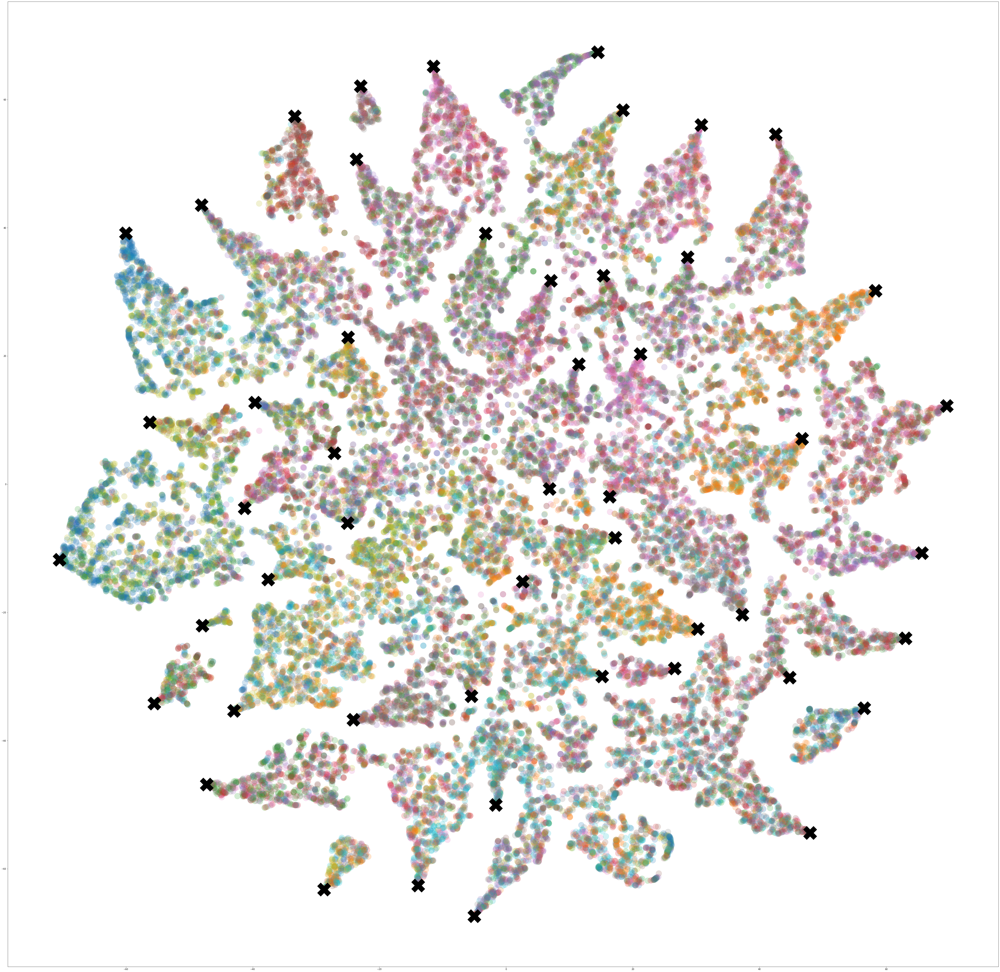

In [5]:
colors = [col for col in mcolors.TABLEAU_COLORS]
cl = [colors[lbl] for lbl in labels]

plt.figure(figsize=(80,80))
ax1 = plt.subplot()
ax1.scatter(X_embedded[:, 0], X_embedded[:, 1], s=700, c=cl, alpha=0.2)

ax1.scatter(X_centroids[:, 0], X_centroids[:, 1], s=3700, c='black', marker='X')

plt.show()

In [6]:
clas_names = ['airplane',
 'automobile',
 'bird',
 'cat',
 'deer',
 'dog',
 'frog',
 'horse',
 'ship',
 'truck']



<BarContainer object of 10 artists>

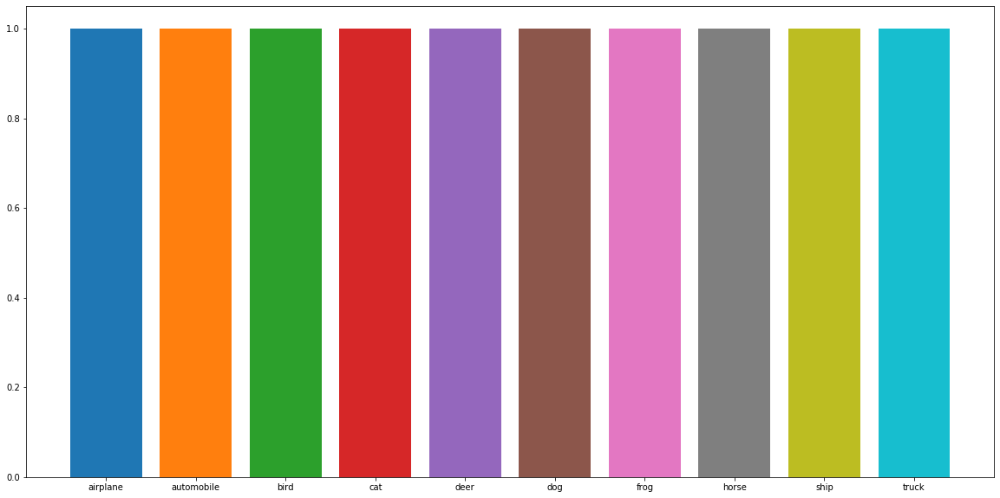

In [7]:
plt.figure(figsize=(20,10))
plt.bar(clas_names, height=1, data=clas_names, color=colors)



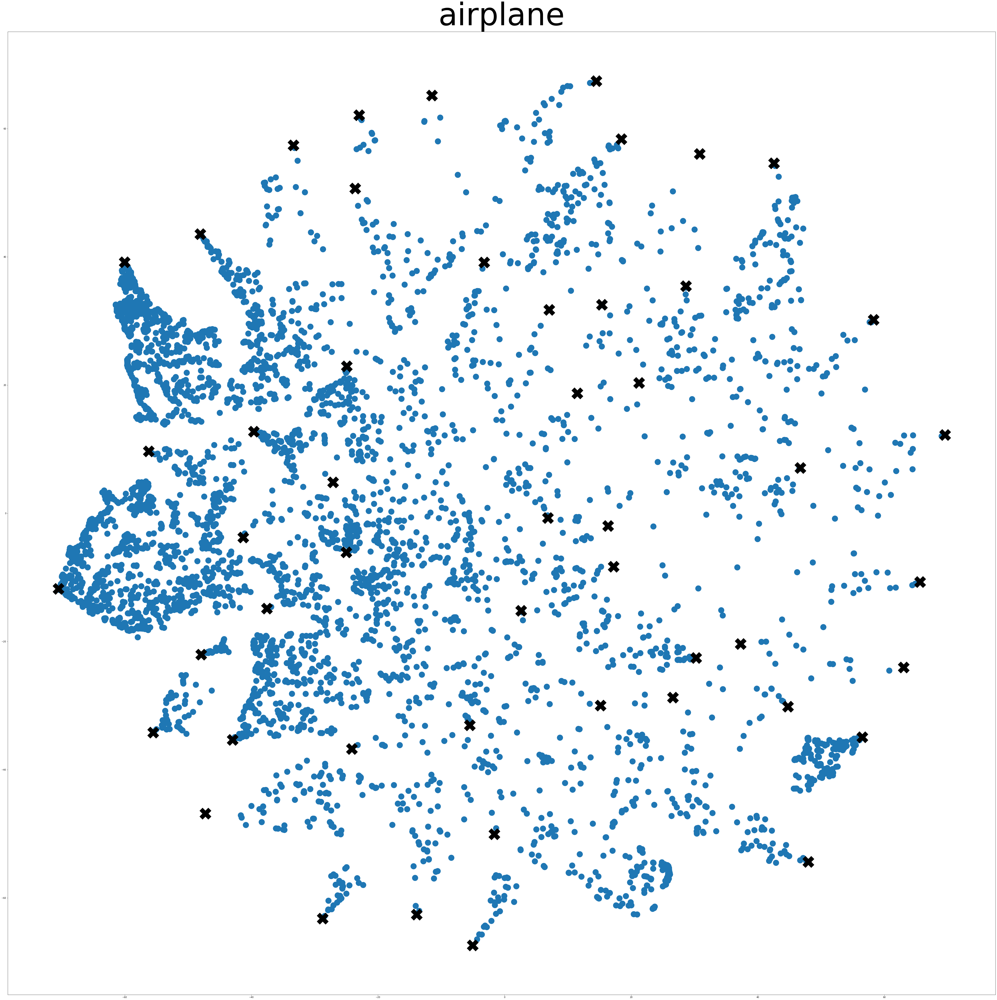

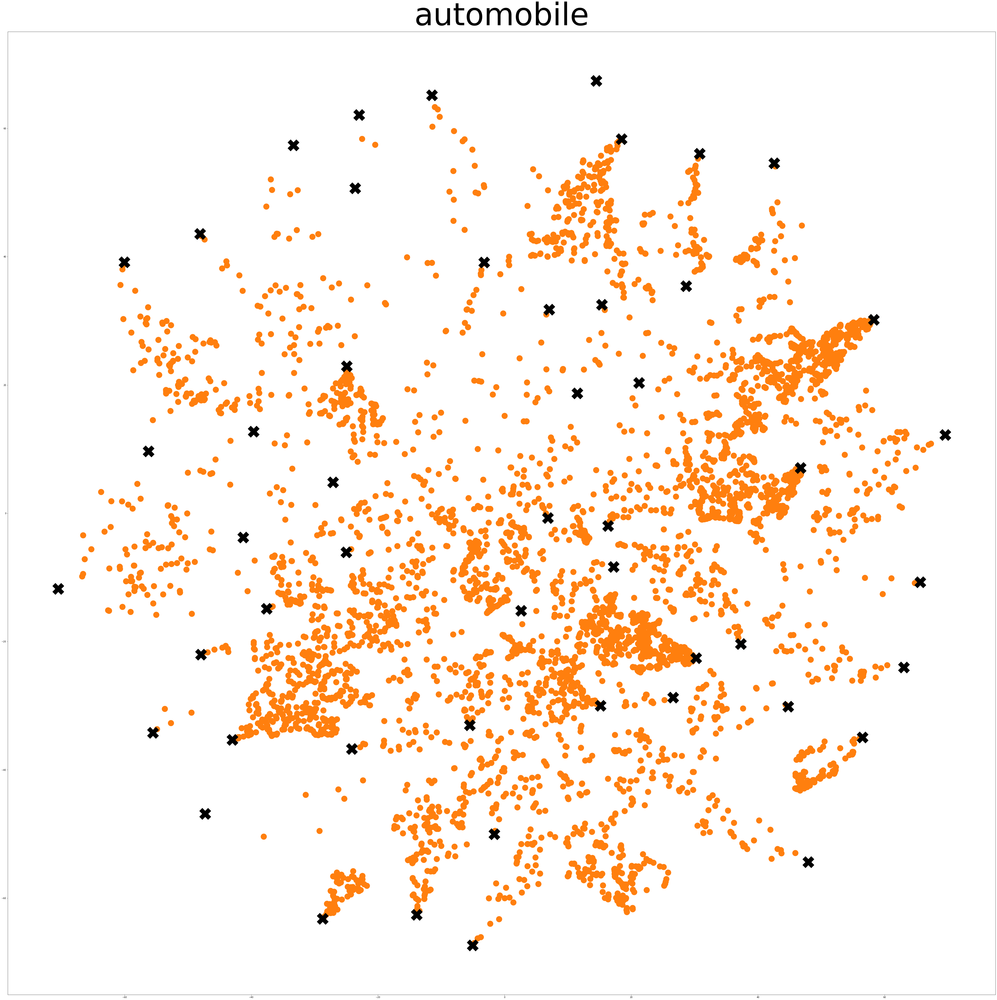

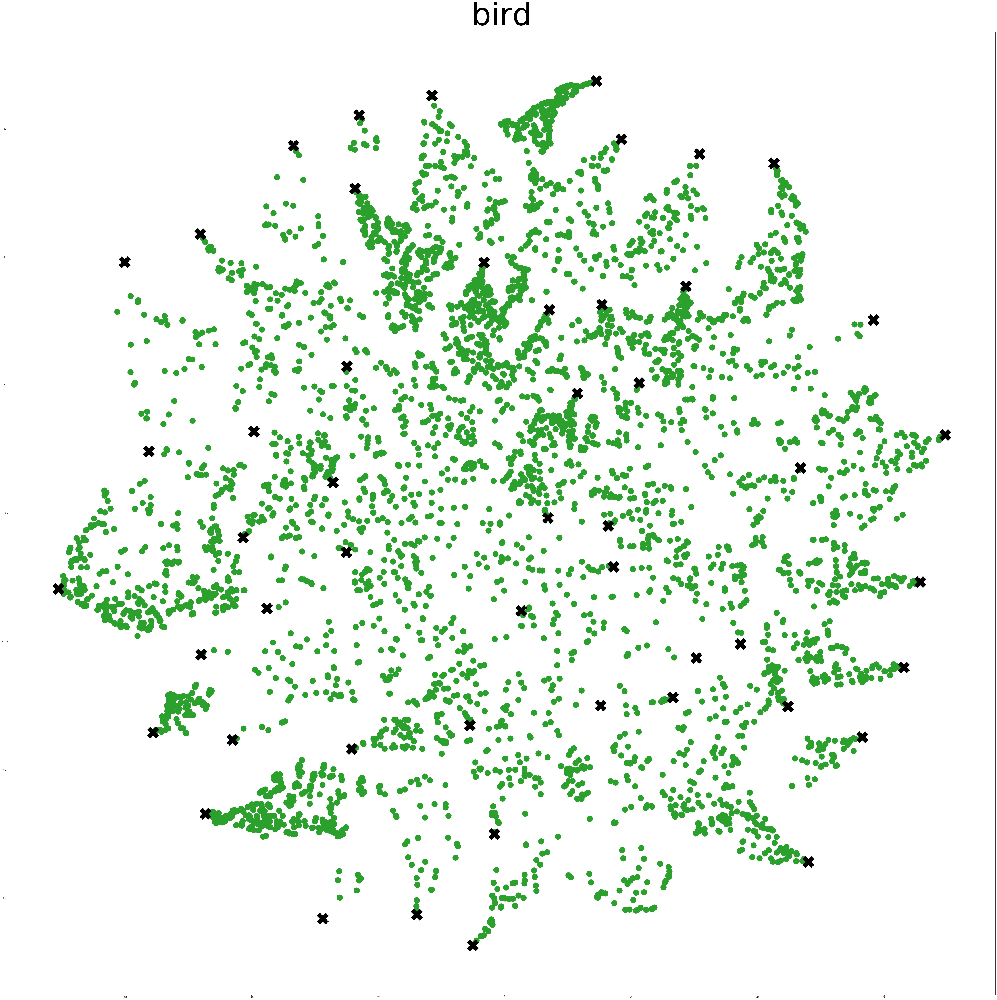

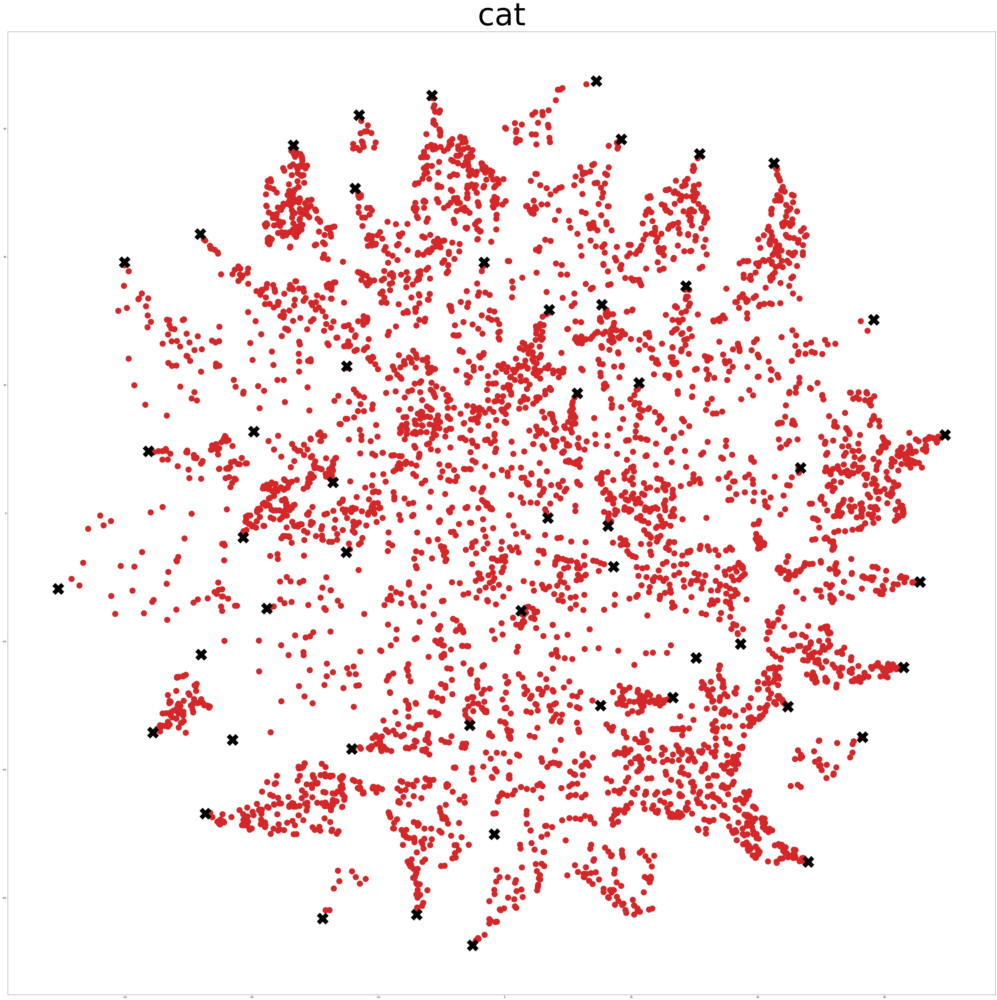

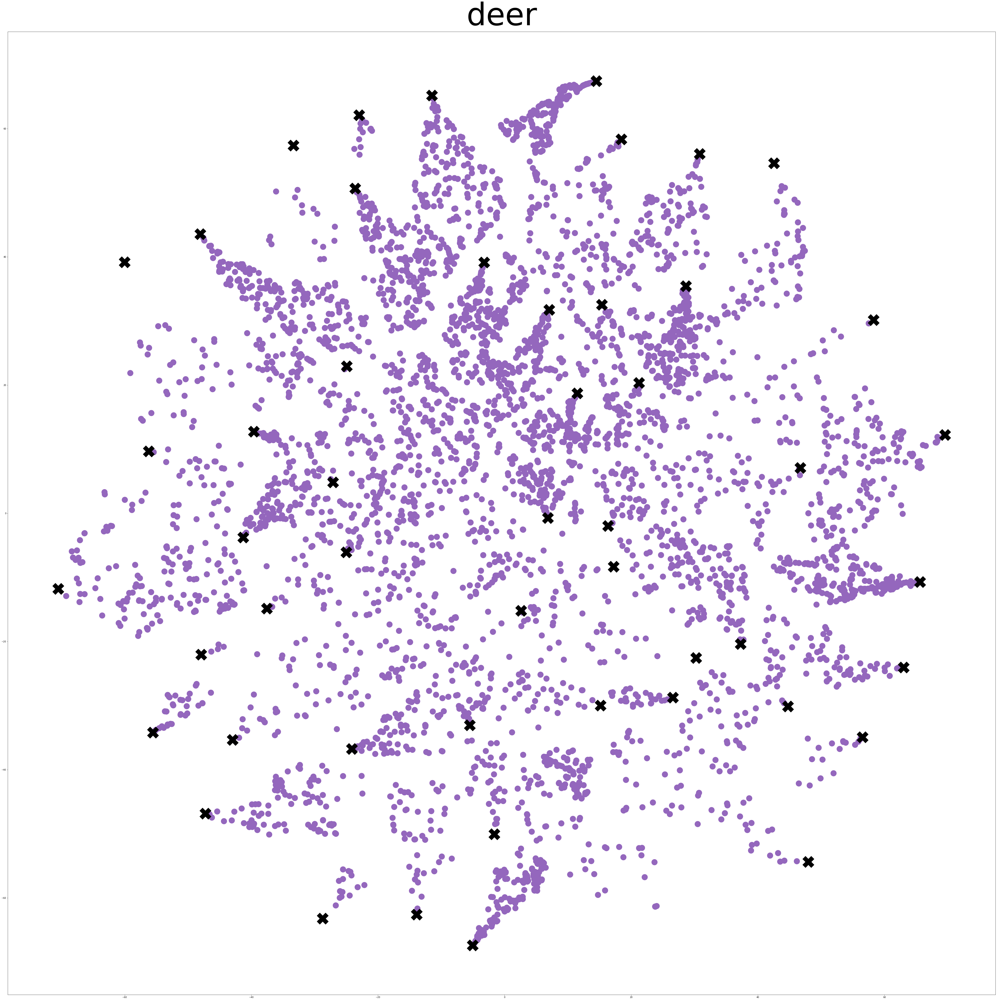

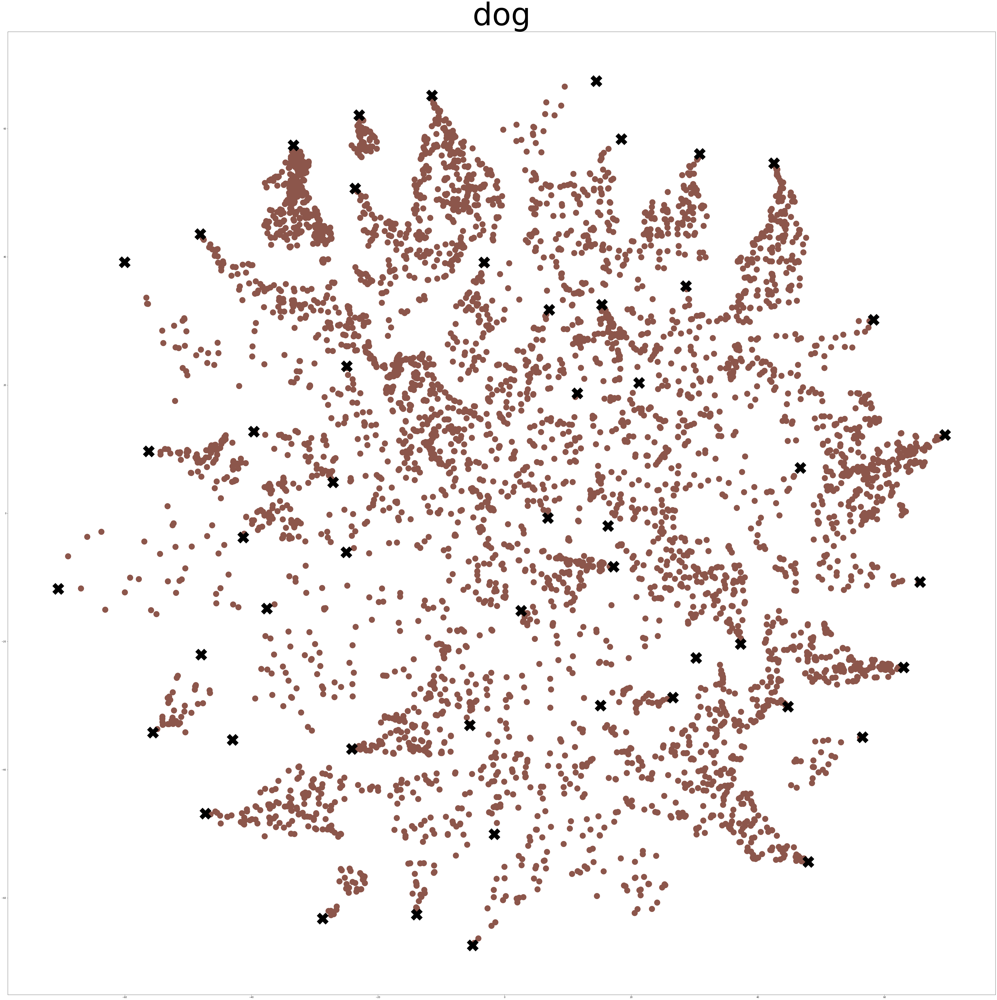

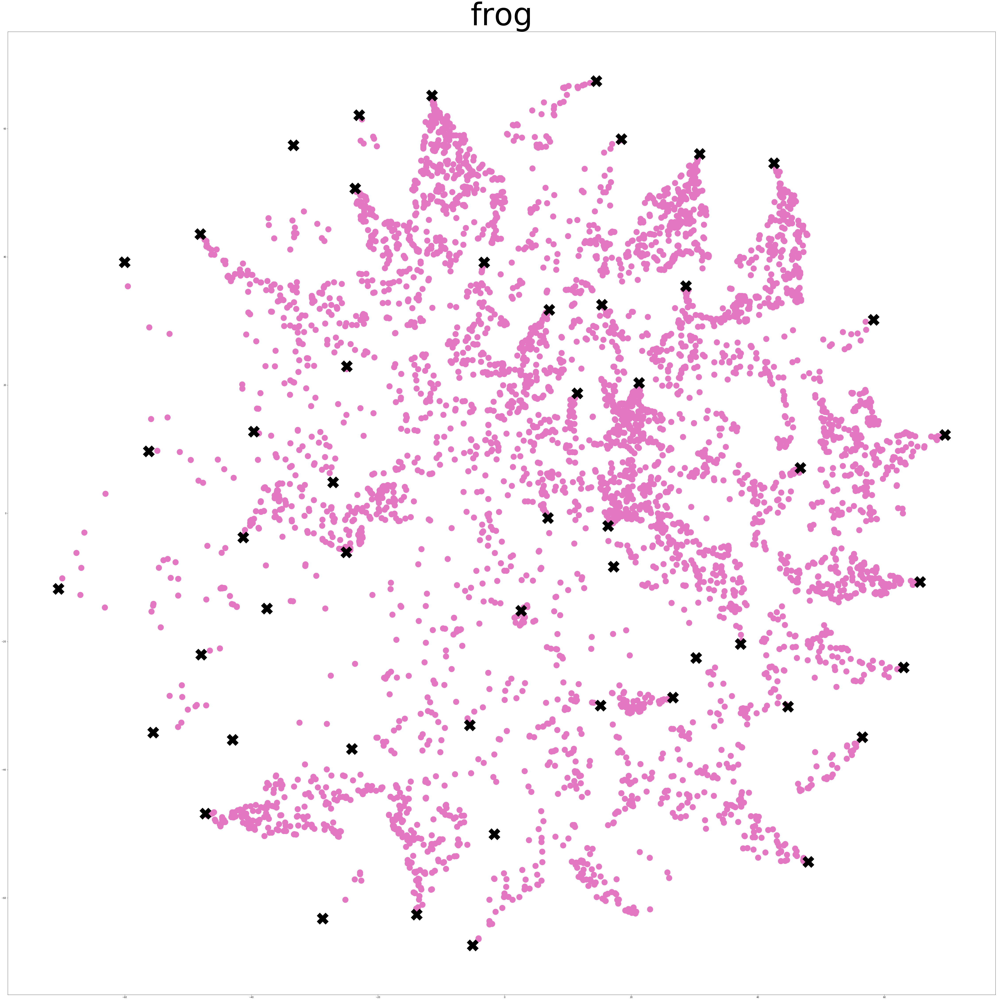

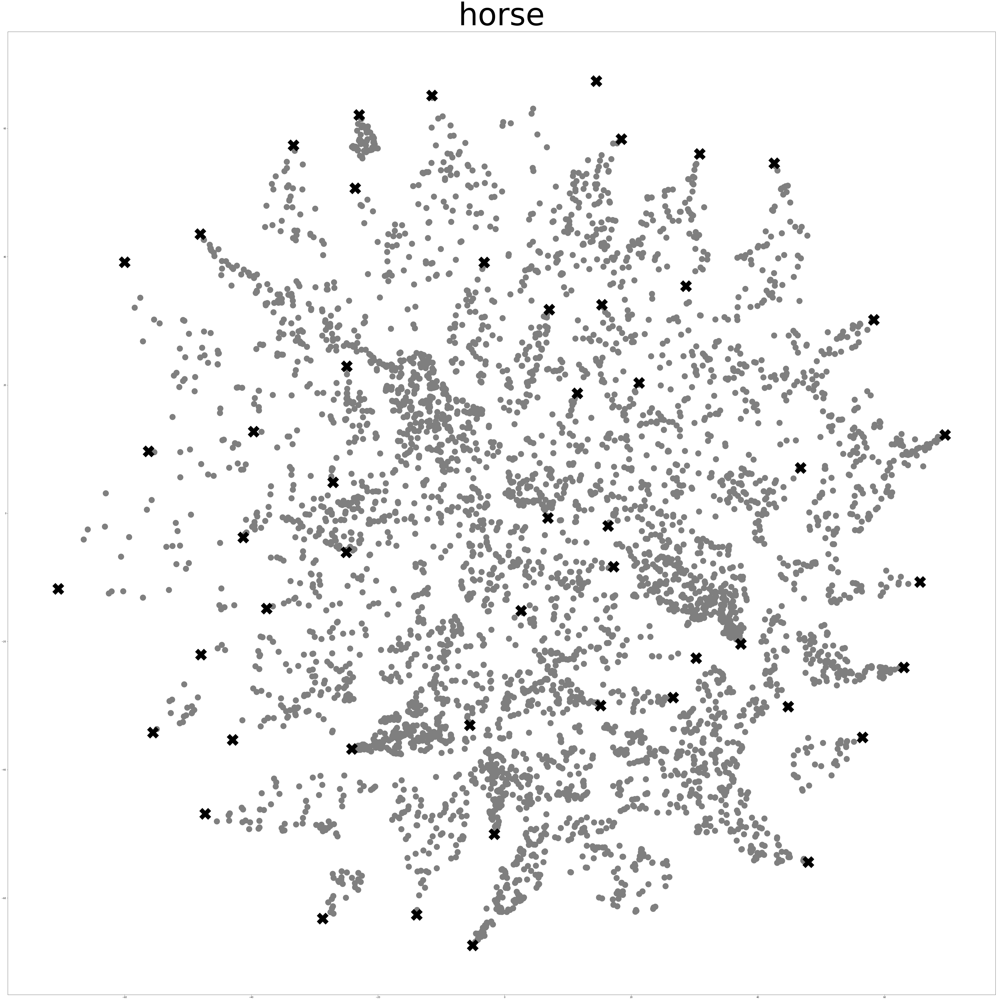

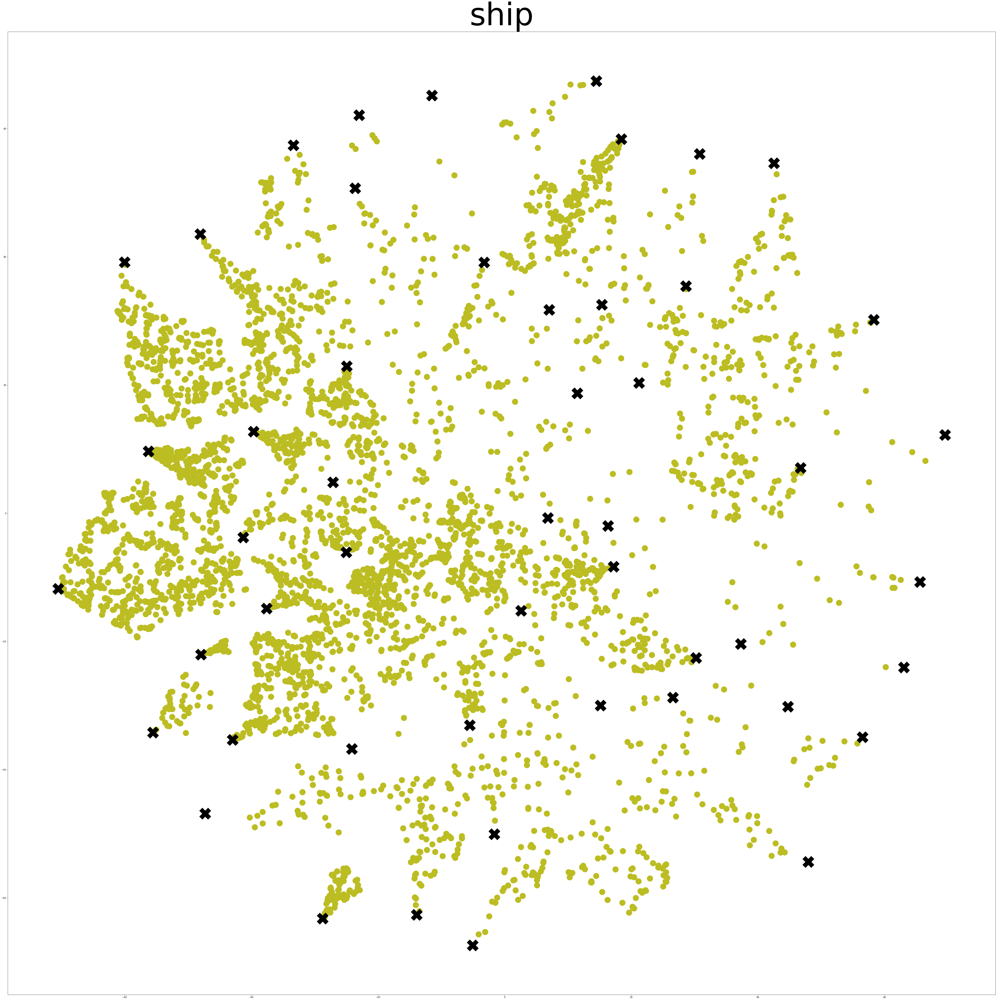

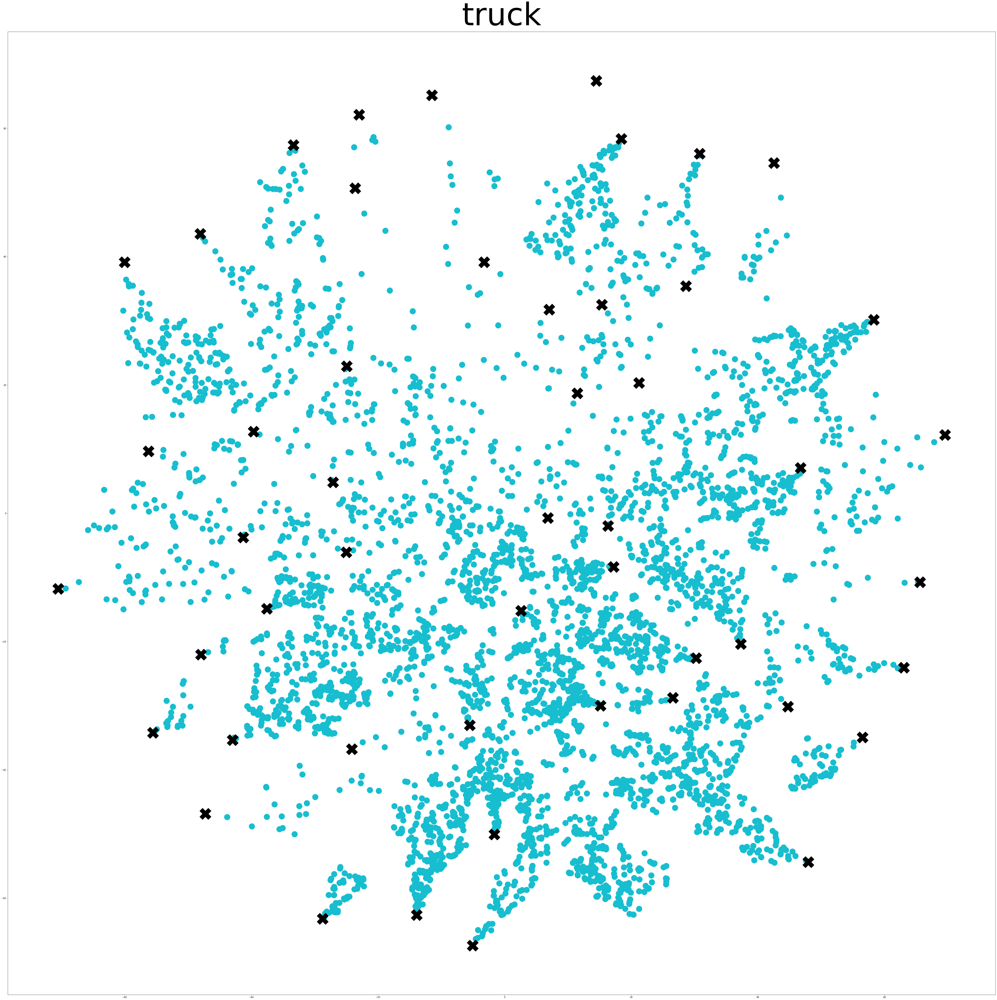

In [8]:
# one class plots
colors = [col for col in mcolors.TABLEAU_COLORS]
cl = [colors[lbl] for lbl in labels]
for l in range(10):
    idx = (labels == l).astype('int').nonzero()
    mas = X_embedded[idx]
    cc = np.array(cl)[idx]
    
    plt.figure(figsize=(80,80))
    ax1 = plt.subplot()
    ax1.scatter(mas[:, 0], mas[:, 1], s=700, c=cc)
    
    ax1.scatter(X_centroids[:, 0], X_centroids[:, 1], s=2700, c='black', marker='X')


    plt.title(clas_names[l], fontsize=140)
    plt.show()